In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

### Import key libraries

In [2]:
!pip install ultralytics matplotlib pillow pyyaml

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 949.3/949.3 kB 16.5 MB/s eta 0:00:00


In [3]:
import os
os.environ['NO_ALBUMENTATIONS_UPDATE'] = '1'  # Suppress Albumentations update warning

import random
import shutil
from PIL import Image
import matplotlib.pyplot as plt
from ultralytics import YOLO
import yaml
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
# Step 1: Define Dataset Paths
train_path = '/kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/train'
valid_path = '/kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/valid'
test_path = '/kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test'

In [5]:
# Step 2: Load and Inspect the Dataset
def load_sample_data(base_path, sample_size=2):
    """
    Load a few samples of images and labels from the given directory.
    
    Args:
        base_path (str): Path to the directory containing 'images' and 'labels'.
        sample_size (int): Number of samples to load from each directory.
    
    Returns:
        dict: A dictionary containing lists of images and their corresponding labels.
    """
    data = {'images': [], 'labels': []}
    image_dir = os.path.join(base_path, 'images')
    label_dir = os.path.join(base_path, 'labels')
    
    # Check if directories exist
    if not os.path.exists(image_dir) or not os.path.exists(label_dir):
        raise FileNotFoundError(f"Image or label directory not found in {base_path}")
    
    # List all image and label files
    image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg') or f.endswith('.png')]
    label_files = [f.replace('.jpg', '.txt').replace('.png', '.txt') for f in image_files]
    
    # Randomly sample a few files
    sampled_files = random.sample(image_files, min(sample_size, len(image_files)))
    
    # Load sampled images and labels
    for file in sampled_files:
        image_path = os.path.join(image_dir, file)
        label_path = os.path.join(label_dir, file.replace('.jpg', '.txt').replace('.png', '.txt'))
        
        # Load image
        image = Image.open(image_path)
        data['images'].append(image)
        
        # Load label
        with open(label_path, 'r') as f:
            label = f.read()
        data['labels'].append(label)
    
    return data

In [6]:
def display_samples(data, title):
    """
    Display sampled images and their corresponding labels.
    
    Args:
        data (dict): Dictionary containing 'images' and 'labels'.
        title (str): Title for the plot.
    """
    plt.figure(figsize=(10, 5))
    for i, (image, label) in enumerate(zip(data['images'], data['labels'])):
        plt.subplot(1, len(data['images']), i + 1)
        plt.imshow(image)
        plt.title(f"Label: {label}")
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

Train samples loaded: 2
Validation samples loaded: 2
Test samples loaded: 2


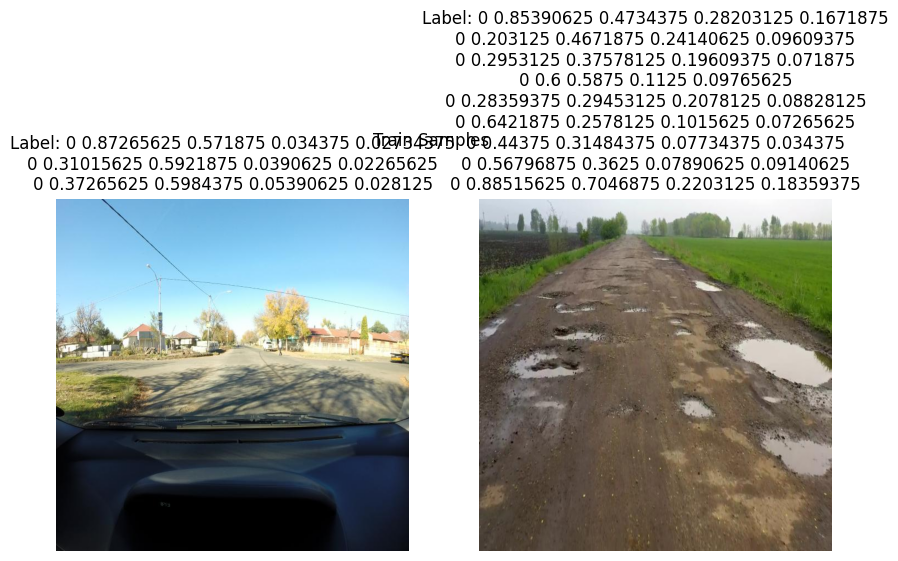

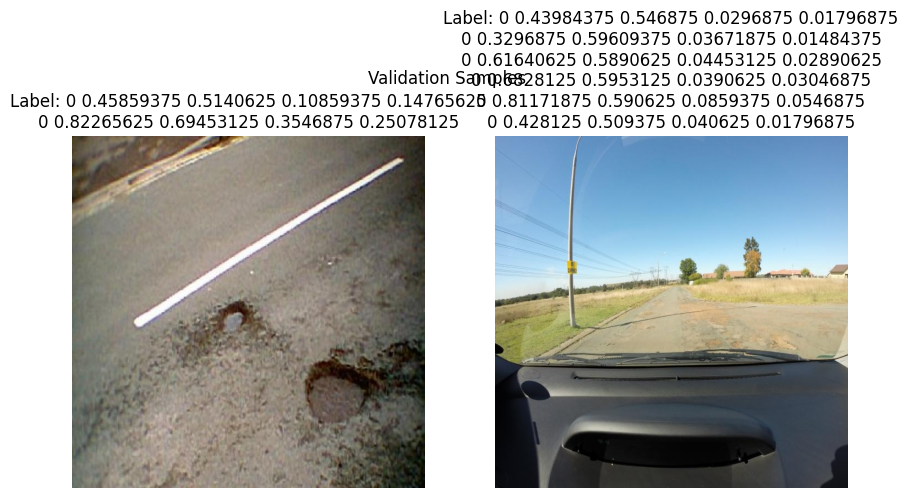

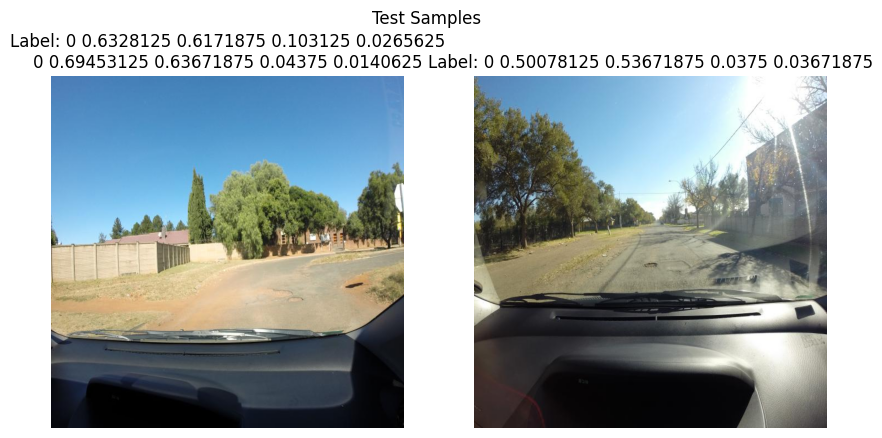

In [7]:
# Load a few samples from each directory
train_data = load_sample_data(train_path, sample_size=2)
valid_data = load_sample_data(valid_path, sample_size=2)
test_data = load_sample_data(test_path, sample_size=2)

# Display the number of samples loaded
print(f"Train samples loaded: {len(train_data['images'])}")
print(f"Validation samples loaded: {len(valid_data['images'])}")
print(f"Test samples loaded: {len(test_data['images'])}")

# Display sampled images and labels
display_samples(train_data, "Train Samples")
display_samples(valid_data, "Validation Samples")
display_samples(test_data, "Test Samples")

In [8]:
# Step 3: Data Augmentation with Albumentations
def get_augmentations():
    """
    Define data augmentations using Albumentations.
    
    Returns:
        A.Compose: Albumentations augmentation pipeline.
    """
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.Rotate(limit=30, p=0.5),
        A.RandomResizedCrop(height=640, width=640, scale=(0.8, 1.0), p=0.5),
        A.Blur(blur_limit=3, p=0.1),
        ToTensorV2(),
    ], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

In [9]:
# Step 4: Prepare Dataset for Training
def prepare_yolo_dataset(base_path, output_path):
    """
    Prepare the dataset in YOLO format for training.
    
    Args:
        base_path (str): Path to the directory containing 'images' and 'labels'.
        output_path (str): Path to save the prepared dataset.
    """
    image_dir = os.path.join(base_path, 'images')
    label_dir = os.path.join(base_path, 'labels')
    
    # Create output directories
    os.makedirs(output_path, exist_ok=True)
    os.makedirs(os.path.join(output_path, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_path, 'labels'), exist_ok=True)
    
    # Copy images and labels to the output directory
    for file in os.listdir(image_dir):
        shutil.copy(os.path.join(image_dir, file), os.path.join(output_path, 'images', file))
    for file in os.listdir(label_dir):
        shutil.copy(os.path.join(label_dir, file), os.path.join(output_path, 'labels', file))

# Prepare the dataset
prepare_yolo_dataset(train_path, 'yolo_dataset/train')
prepare_yolo_dataset(valid_path, 'yolo_dataset/valid')
prepare_yolo_dataset(test_path, 'yolo_dataset/test')

In [10]:
# Step 5: Create YAML File for Dataset
data_yaml = """
train: /kaggle/working/yolo_dataset/train/images
val: /kaggle/working/yolo_dataset/valid/images
test: /kaggle/working/yolo_dataset/test/images

nc: 1  # Number of classes (porthole detection)
names: ['porthole']
"""

with open('dataset.yaml', 'w') as f:
    f.write(data_yaml)


In [11]:
# Step 6: Train the Model with 2x T4 GPUs
def train_yolo_model(data_yaml, epochs=100, imgsz=640, hyperparams=None):
    """
    Train a YOLO model with hyperparameter tuning and 2x T4 GPUs.
    
    Args:
        data_yaml (str): Path to the YAML file containing dataset configuration.
        epochs (int): Number of training epochs.
        imgsz (int): Image size for training.
        hyperparams (dict): Dictionary of hyperparameters for tuning.
    
    Returns:
        results: Training results object from Ultralytics YOLO.
        model: Trained YOLO model.
    """
    try:
        # Load a pre-trained YOLO model
        model = YOLO('yolov8s.pt')  # Use 'yolov8s' instead of 'yolov8n'
        
        # Hyperparameter tuning
        if hyperparams is None:
            hyperparams = {
                'lr0': 0.01,  # Initial learning rate
                'momentum': 0.937,  # Momentum
                'weight_decay': 0.0005,  # Weight decay
                'warmup_epochs': 3,  # Warmup epochs
            }
        
        # Train the model with hyperparameters and 2x T4 GPUs
        results = model.train(data=data_yaml, epochs=epochs, imgsz=imgsz, device='0,1', batch=16, **hyperparams)
        return results, model  # Return both results and model
    except Exception as e:
        print(f"Error during training: {e}")
        return None, None

In [12]:
# Step 7: Generate and Save Model Metrics Plots
def save_metrics_plots(results):
    """
    Save model metrics plots (precision, recall, mAP, confusion matrix).
    
    Args:
        results: Training results object from Ultralytics YOLO.
    """
    if results is None:
        print("No results to plot. Training may have failed.")
        return
    
    try:
        # Plot precision-recall curve
        results.plot_curve('precision_recall_curve.png')
        
        # Plot confusion matrix
        results.plot_curve('confusion_matrix.png')
        
        # Plot mAP curve
        results.plot_curve('map_curve.png')
    except Exception as e:
        print(f"Error while saving metrics plots: {e}")

In [13]:
import cv2

100%|██████████| 21.5M/21.5M [00:00<00:00, 98.8MB/s]


Ultralytics 8.3.92 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
                                                       CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=dataset.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0,1, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf

100%|██████████| 755k/755k [00:00<00:00, 16.3MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

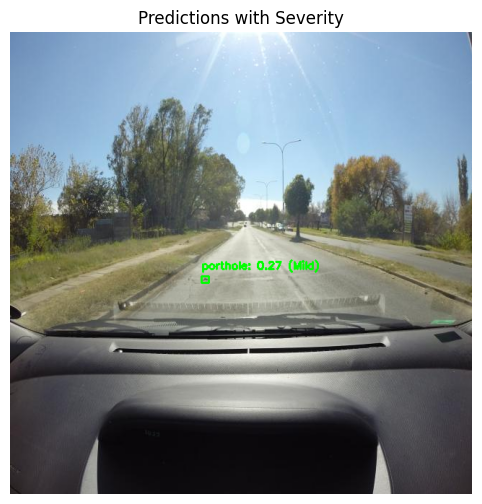


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0089362_JPG.rf.c690154fa25145c5b6f5289e19f5618e.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 27.8ms postprocess per image at shape (1, 3, 640, 640)


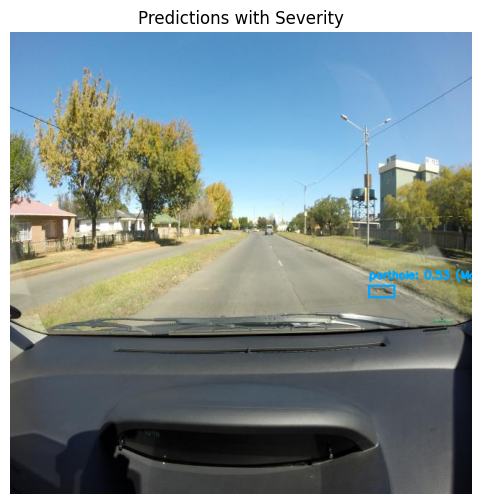


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/883275_RS_290_290RS150131_17105_RAW_jpg.rf.396c7f1766153074bd455b5887309734.jpg: 640x640 9 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


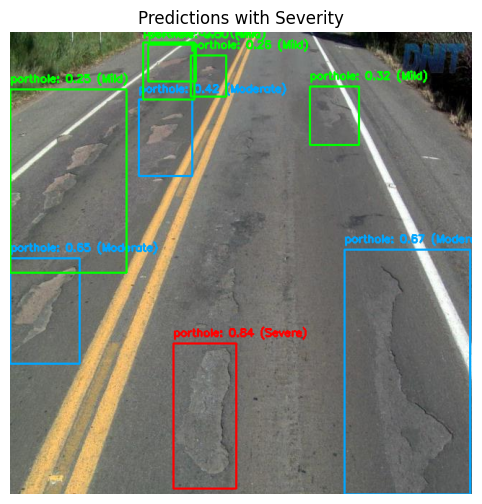


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0029468_JPG.rf.4825adebba27b494d78db65387d21597.jpg: 640x640 2 portholes, 16.2ms
Speed: 1.6ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


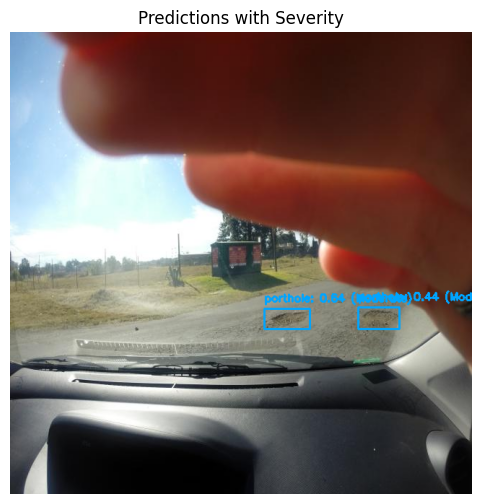


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0031652_JPG.rf.9dc53a8a594e1be18eb3d5c1a7895bd5.jpg: 640x640 3 portholes, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


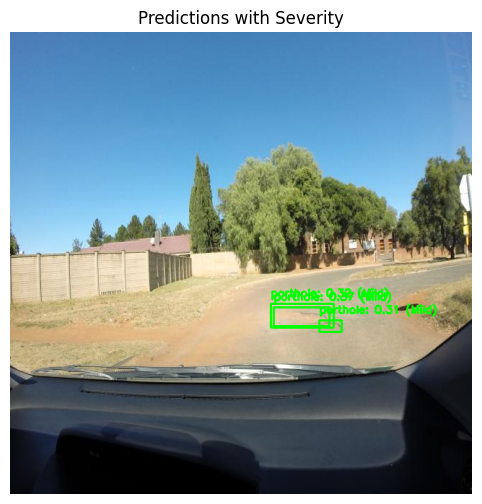


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/5_png_jpg.rf.3b6c592a66d5ce9f657960fa139ae66c.jpg: 640x640 2 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


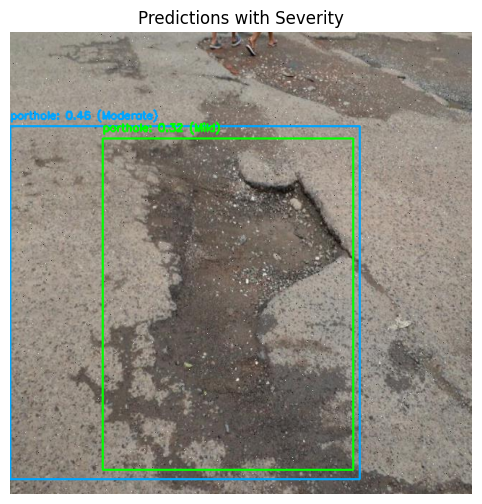


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1025819_RS_386_386RS169832_08835_RAW_jpg.rf.3eb0043341d7cc30565c9786afeee8ae.jpg: 640x640 1 porthole, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


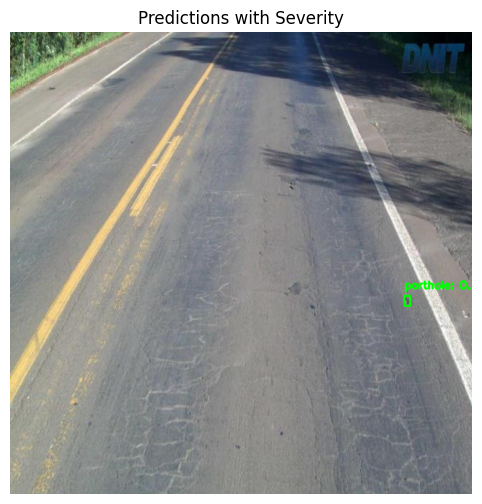


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0066624_JPG.rf.609b57fcc23c4c74d3b2deac8996c728.jpg: 640x640 20 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


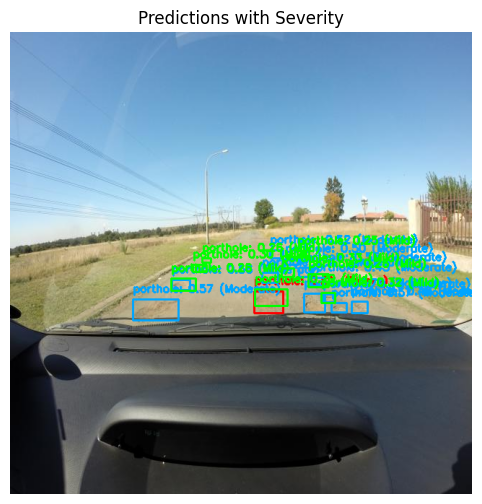


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0090209_JPG.rf.7e01a46ba171a39513cba3fd2caceaef.jpg: 640x640 7 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


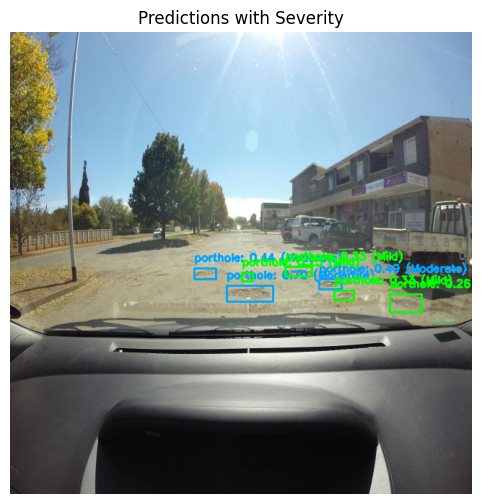


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/43_jpg.rf.295f5326d43b9d7a3e9ed7cee05f2efc.jpg: 640x640 4 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


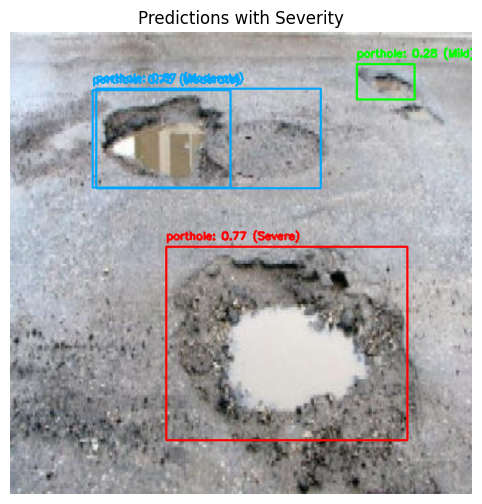


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/919253_RS_290_290RS294095_29715_RAW_jpg.rf.d2f121fd14685b035000522cd71032e3.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


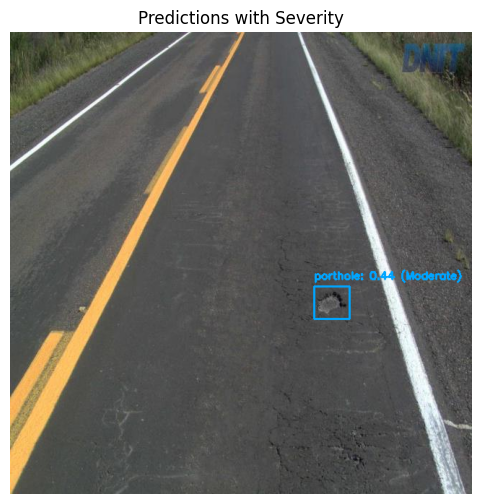


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/919252_RS_290_290RS294095_29711_RAW_jpg.rf.cdead018b5cf65740e6a884441a7884a.jpg: 640x640 1 porthole, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


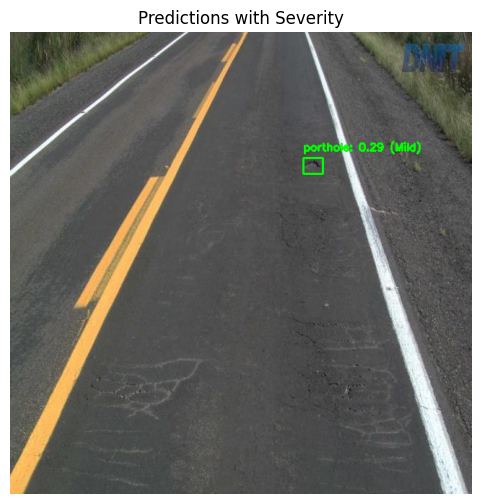


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0028892_JPG.rf.56e56ba0a5877f2394a255a786206533.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


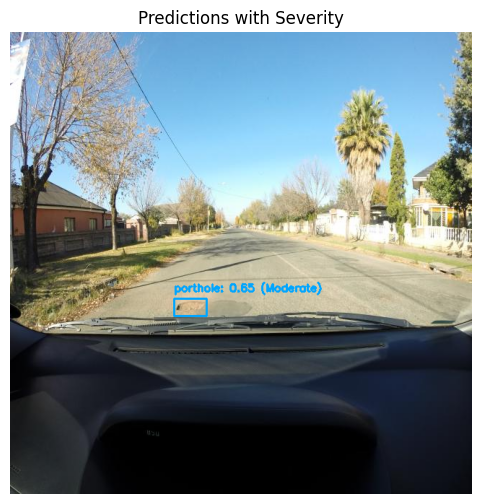


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1025817_RS_386_386RS169832_08825_RAW_jpg.rf.4f2e3009e125b43d6f2b94c9322a2941.jpg: 640x640 5 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


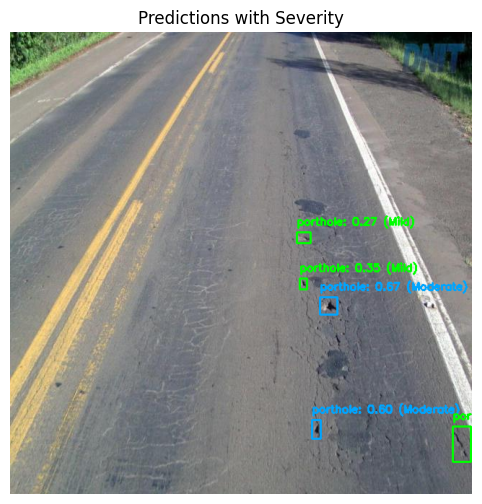


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1044260_DF_060_060BDF0050_00122_RAW_jpg.rf.2d44773556c274ec56f8f206a3ca6212.jpg: 640x640 (no detections), 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


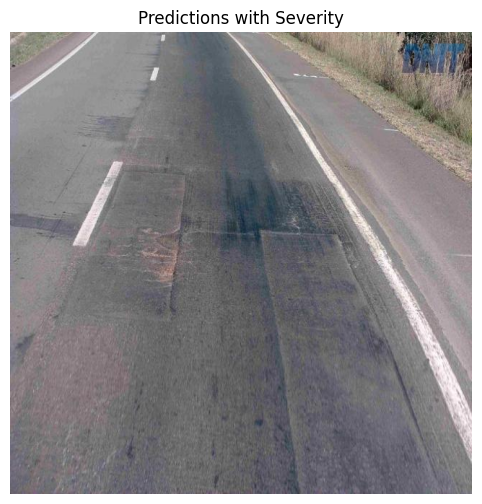


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0066628_JPG.rf.241811251a09c657073a82802a16a98a.jpg: 640x640 9 portholes, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


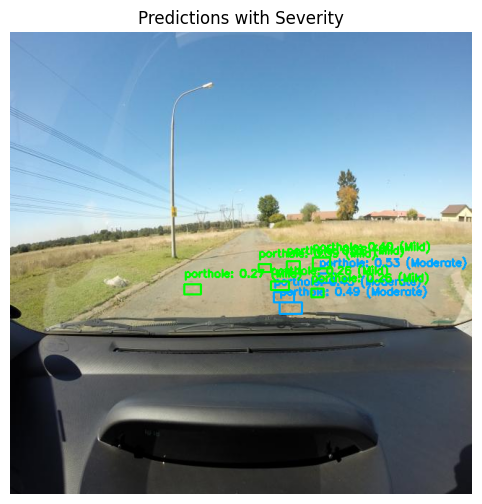


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/102_jpg.rf.0e0ac889083c26d4bb22ef04ba89f979.jpg: 640x640 2 portholes, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


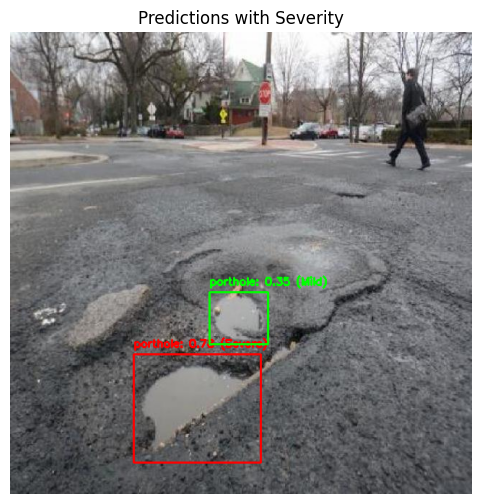


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0066598_JPG.rf.552cf6792c71180500e7529fd25aeedc.jpg: 640x640 6 portholes, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


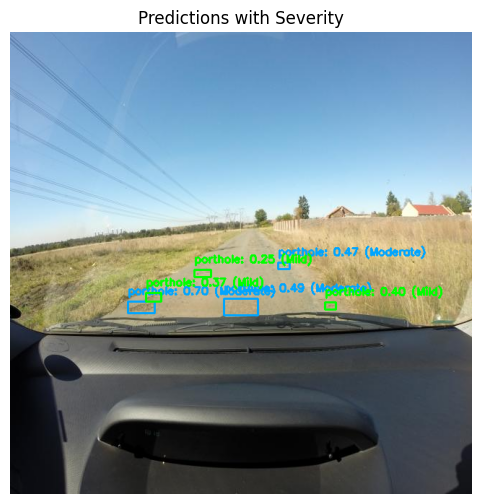


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0088599_JPG.rf.68524068b48aca62ea9aea75b271e4f0.jpg: 640x640 1 porthole, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


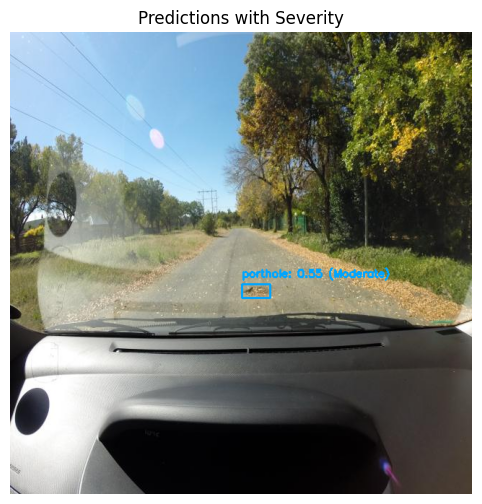


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014748_RS_386_386RS124739_30665_RAW_jpg.rf.cafbfec901452edfbb14611ead7186ae.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


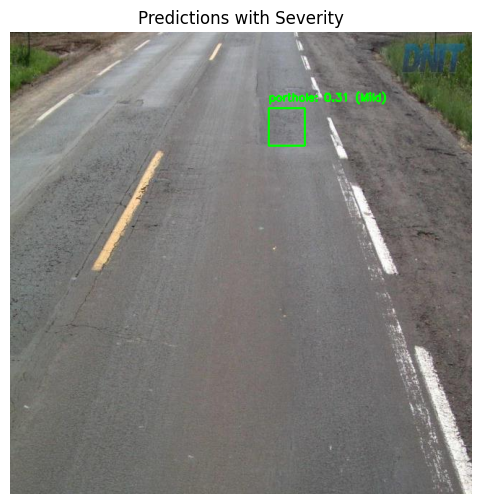


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0088832_JPG.rf.587a9ad9c58f8b0dd788770a1bfa1800.jpg: 640x640 4 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


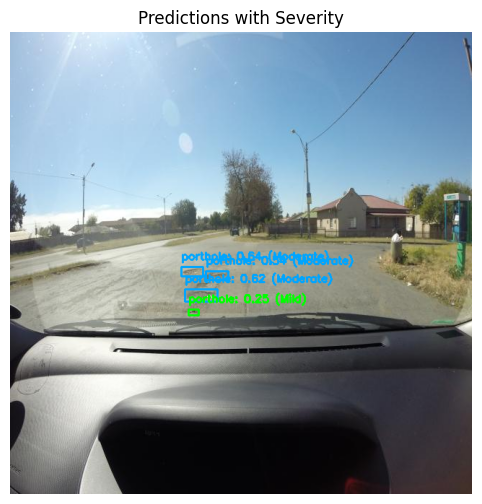


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014760_RS_386_386RS124739_30725_RAW_jpg.rf.599598b829254013fd489f18f5862067.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


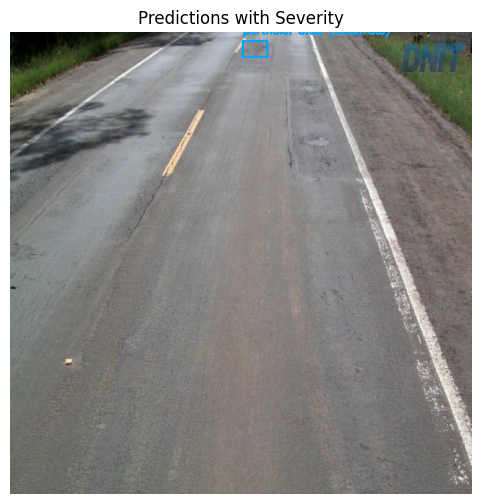


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/180_jpg.rf.9218627c7ff27e3c56e5f31ba90bf45d.jpg: 640x640 4 portholes, 16.3ms
Speed: 1.9ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


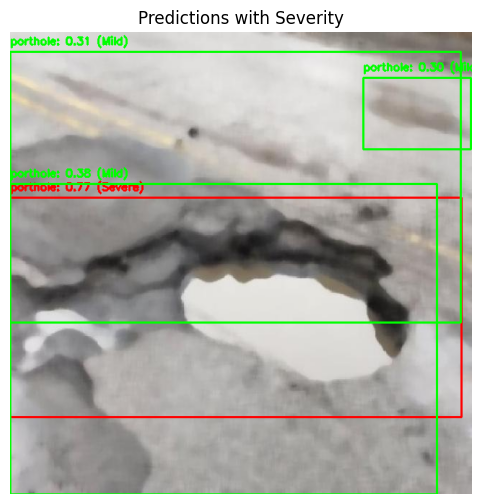


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0029314_JPG.rf.632562a84d556243e1f0724ca0c05a50.jpg: 640x640 (no detections), 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


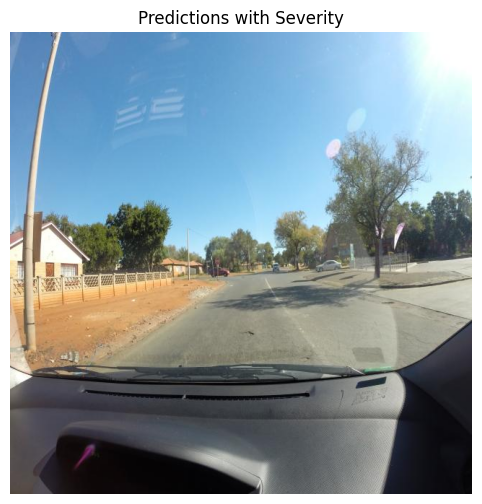


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/883255_RS_290_290RS150131_17005_RAW_jpg.rf.16fc98ce0a73cdc31d027269c02839b2.jpg: 640x640 14 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


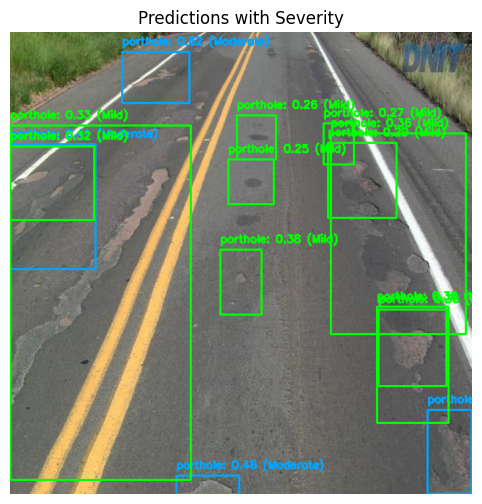


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0089237_JPG.rf.977639fdadfcf5f932d47d57bc764e83.jpg: 640x640 3 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


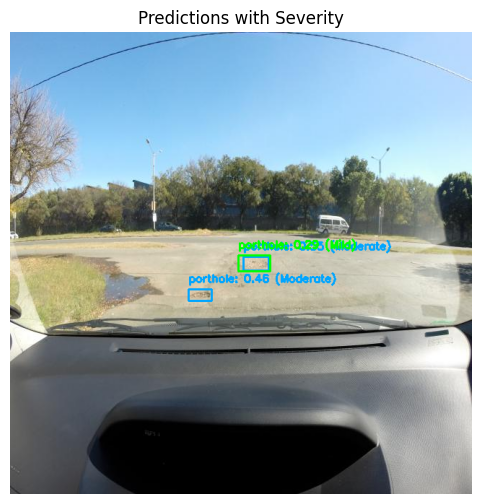


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1084435_DF_080_080BDF0090_01660_RAW_jpg.rf.3fa4ae42e4879cafa148b2bd81d07918.jpg: 640x640 1 porthole, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


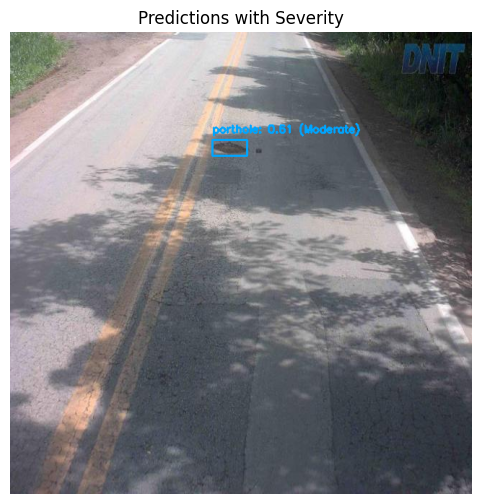


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0090187_JPG.rf.595452388d3fb4f435648d50ae2a50ec.jpg: 640x640 2 portholes, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


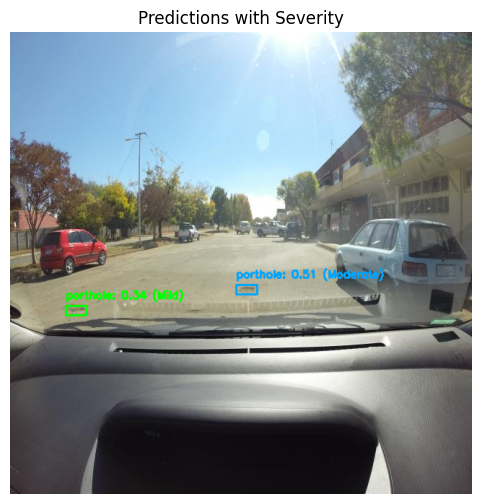


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/916653_RS_290_290RS294095_16715_RAW_jpg.rf.f1ab9408ab1ae0c5ab2d1a84e7d45c9a.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


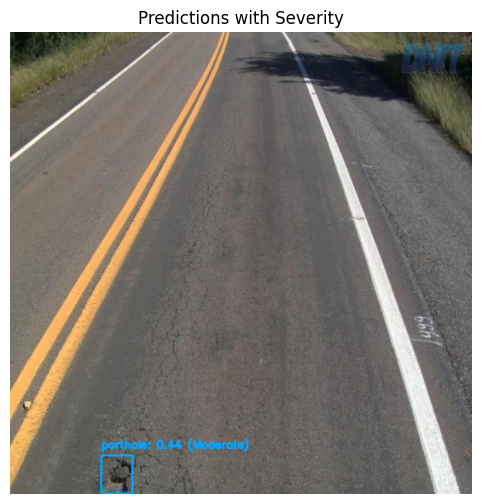


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0029605_JPG.rf.ce1aa92a1a11ab4740f6afe01011748d.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


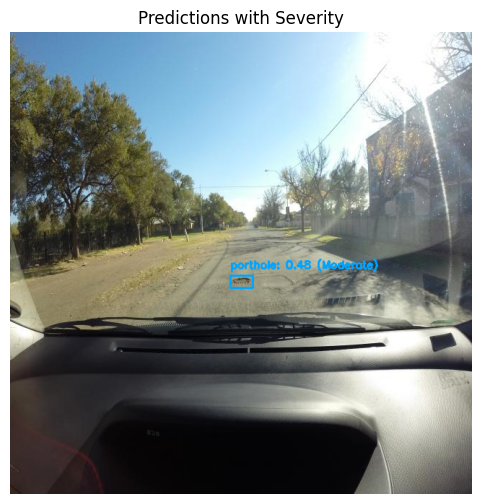


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/images59_jpg.rf.15df548030c06f148614673450acb26c.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


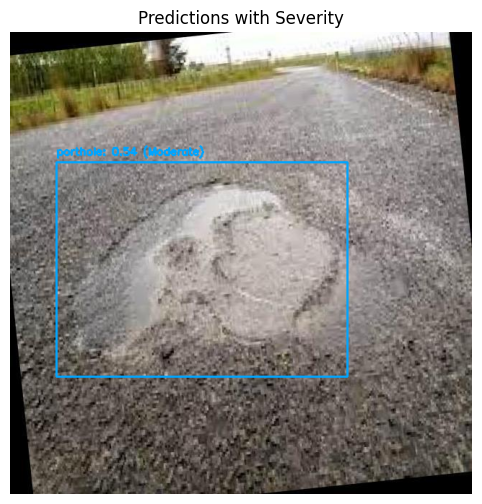


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1090732_DF_070_070BDF0050_06657_RAW_jpg.rf.8ad16df4957cfb0608fb025e043fbf36.jpg: 640x640 (no detections), 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


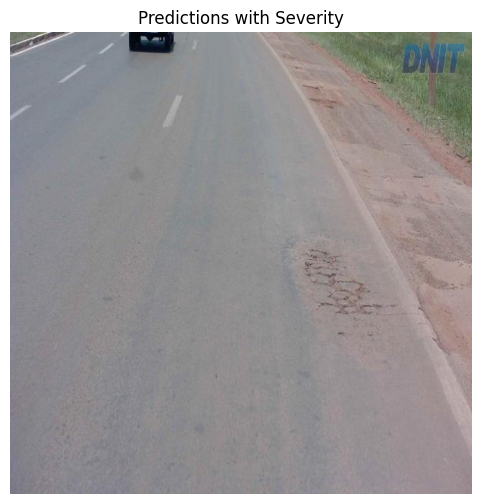


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0031611_JPG.rf.fee8b2a958e84f265a1333939d5870cf.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


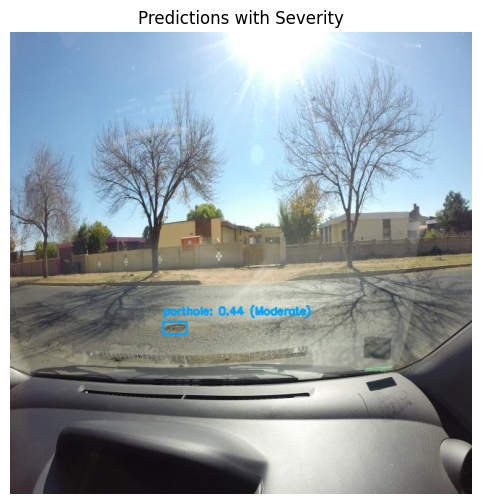


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014745_RS_386_386RS124739_30651_RAW_jpg.rf.c096a4242067d93b7f2dfa42b979eea8.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


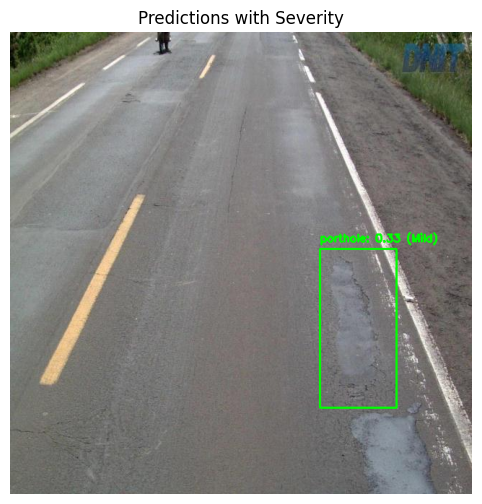


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0066636_JPG.rf.187ca6ff58d6a7a6d0cc28471746b7fb.jpg: 640x640 12 portholes, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


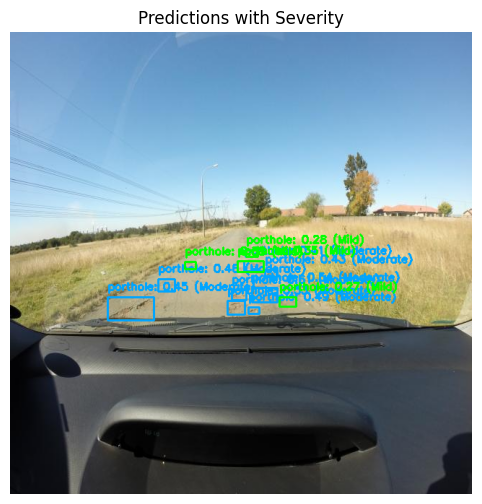


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/8_jpeg_jpg.rf.f43ed0c101b8378ff876a5e926a9a04a.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


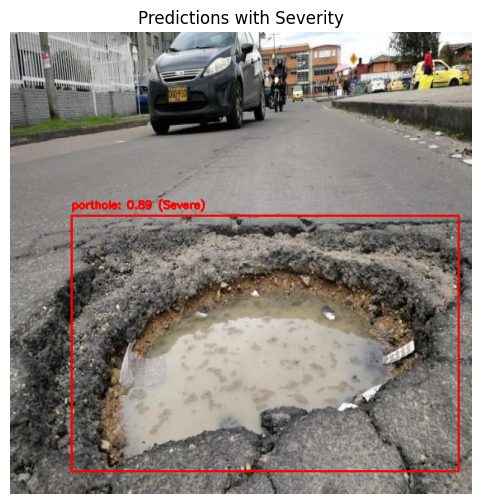


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014790_RS_386_386RS124739_30875_RAW_jpg.rf.5ec9cb2f74eb278d4294b5f877c1ac45.jpg: 640x640 2 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


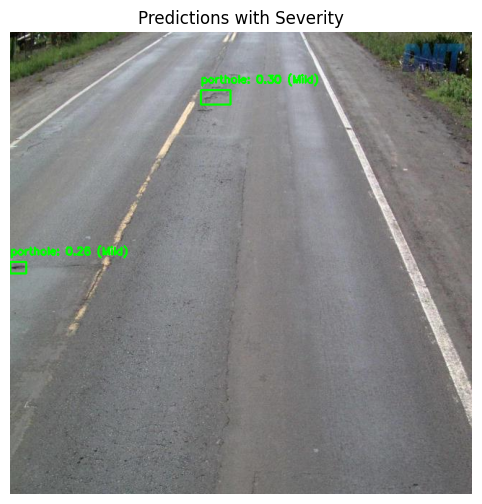


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014903_RS_386_386RS124739_31441_RAW_jpg.rf.54620e2fae32a57eb3c17848c301ef40.jpg: 640x640 (no detections), 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


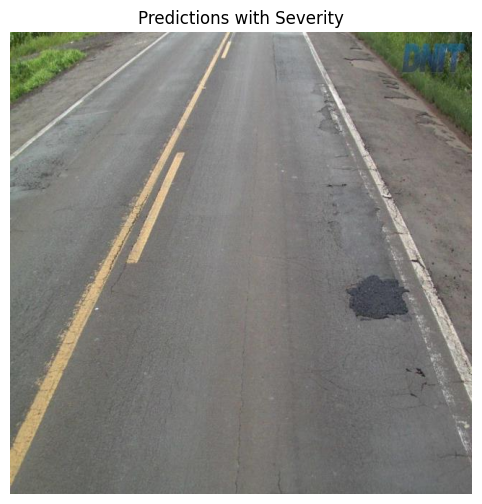


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0088621_JPG.rf.ca50a95a28e8e33d81d5cd4fe5915419.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


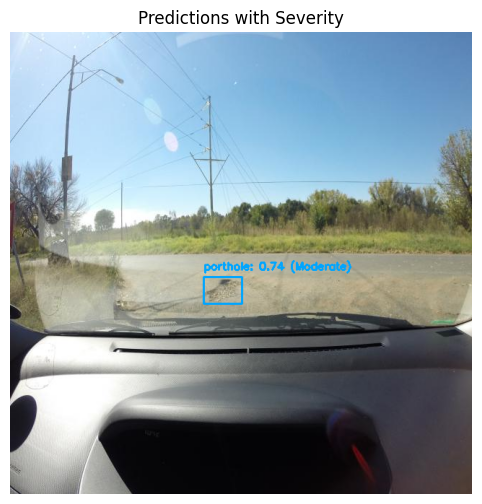


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/941508_RS_290_290RS070691_00445_RAW_jpg.rf.bdcaf87d19498aea48594c5334a80f30.jpg: 640x640 4 portholes, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


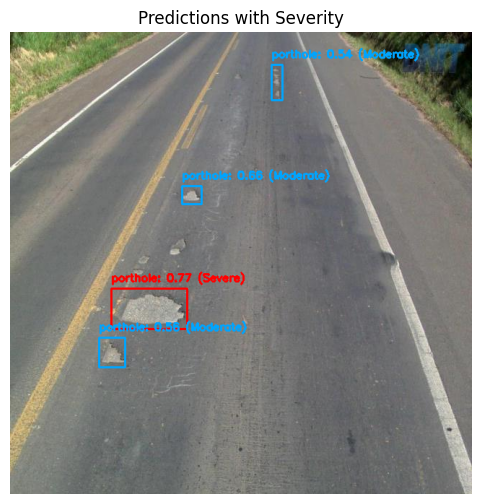


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/916682_RS_290_290RS294095_16860_RAW_jpg.rf.ba8c3677afd3a390995dfb1a4aaa9f11.jpg: 640x640 4 portholes, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


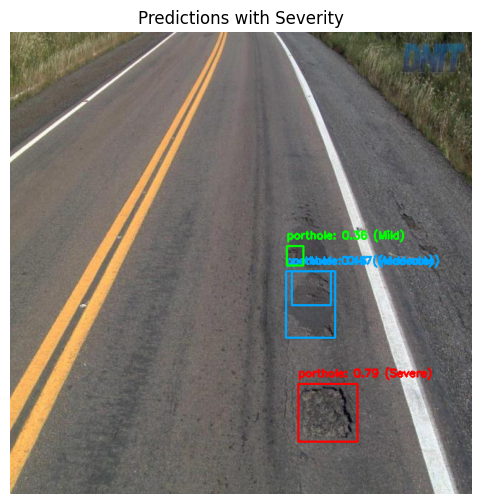


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014783_RS_386_386RS124739_30840_RAW_jpg.rf.3734fa1209204c0aec525d6c76e754a1.jpg: 640x640 2 portholes, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


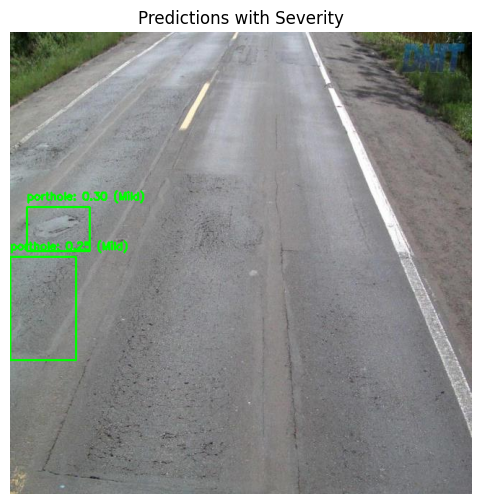


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1083021_DF_080_080BDF0070_03280_RAW_jpg.rf.871bc734513afc6e6dd71feb5966d658.jpg: 640x640 (no detections), 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


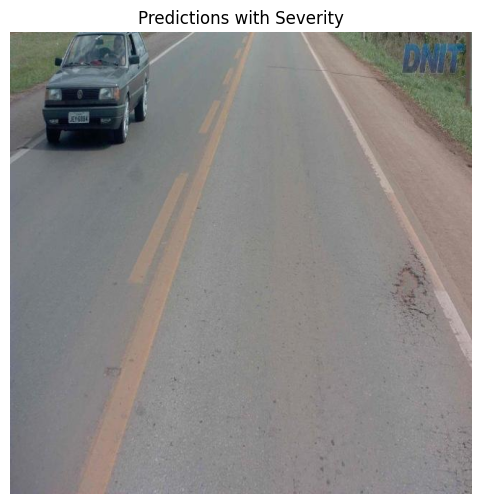


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1091172_DF_070_070BDF0050_07513_RAW_jpg.rf.d26430910b1f115e98ad9eaca9328351.jpg: 640x640 (no detections), 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


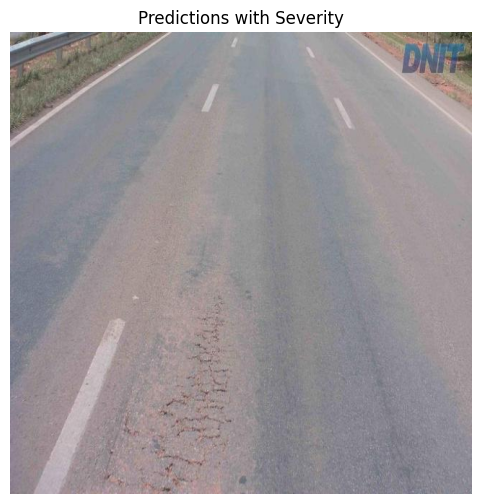


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/915960_RS_290_290RS294095_13250_RAW_jpg.rf.b76b3debbfef9b909808aaaea3a2e8bf.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


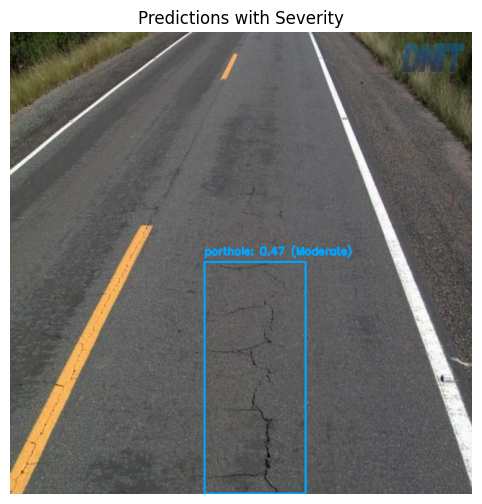


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0027409_JPG.rf.e880cb9242a9f31337803f659a052891.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


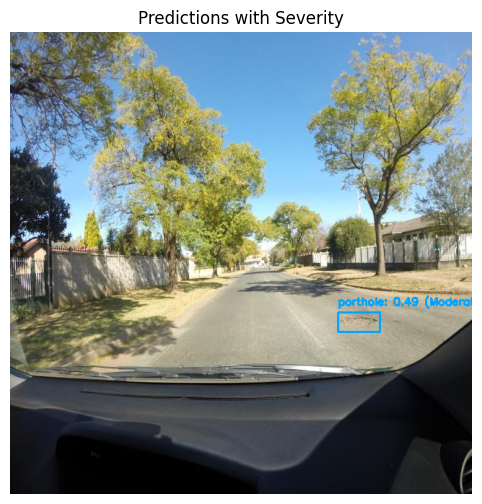


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014800_RS_386_386RS124739_30925_RAW_jpg.rf.be37fab8e943722e7488cdfdac469acb.jpg: 640x640 3 portholes, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


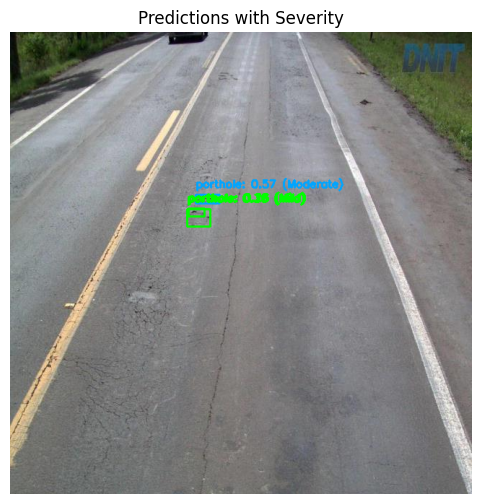


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/941579_RS_290_290RS070691_00800_RAW_jpg.rf.fbe97b0f3f502189f5cf42b5c80fafa2.jpg: 640x640 3 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


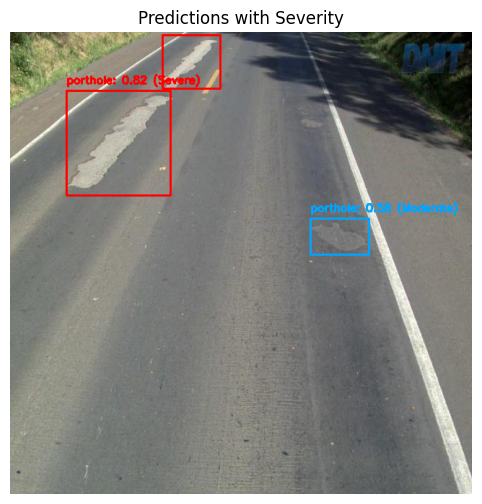


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/143_jpg.rf.ba1be46b32f6a1aa28166313ef66e596.jpg: 640x640 10 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


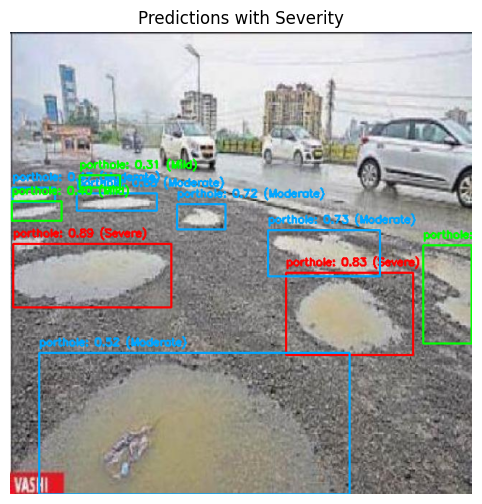


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/153_jpg.rf.4b93beaa8f2c015b879c64152612be3b.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


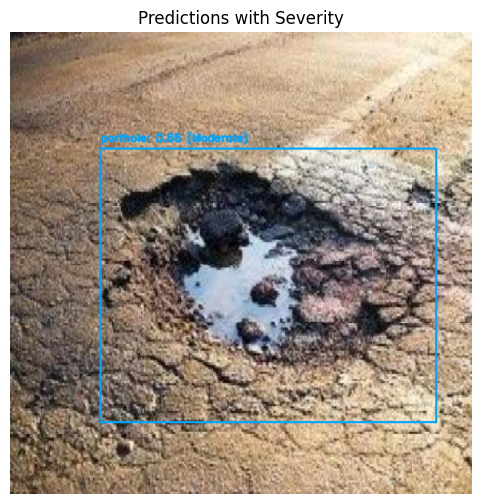


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/images-25-_jpg.rf.b82e47e2d43b867d0f5cb98d0e2f3544.jpg: 640x640 (no detections), 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


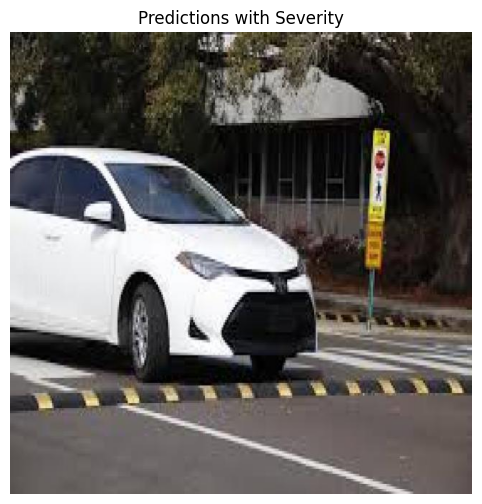


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/concrete-road-bumps_jpg.rf.b7cdea4ed8f6ae3ad13f75de5df727ce.jpg: 640x640 (no detections), 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


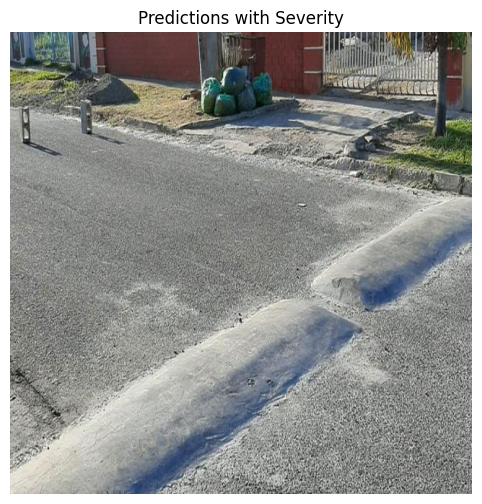


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0031021_JPG.rf.adcb3b7a02a6814c9d61c27a4fe8d60e.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


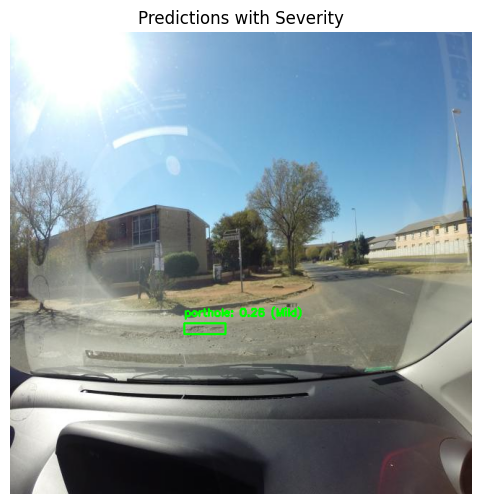


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/941599_RS_290_290RS070691_00900_RAW_jpg.rf.faaa9765fa2376a3ce010a8da22fe55a.jpg: 640x640 6 portholes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


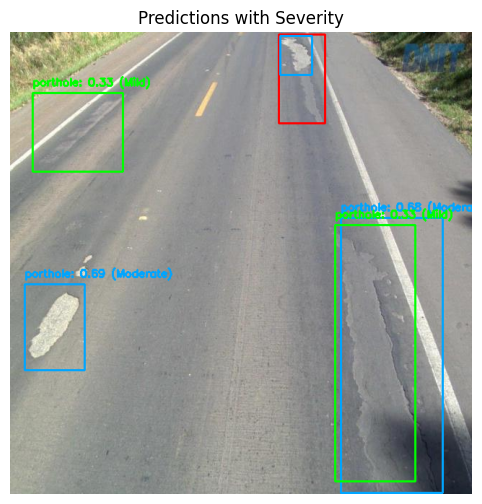


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/665_jpg.rf.2fc6e37cf6ac378c58221c954026cd0a.jpg: 640x640 1 porthole, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


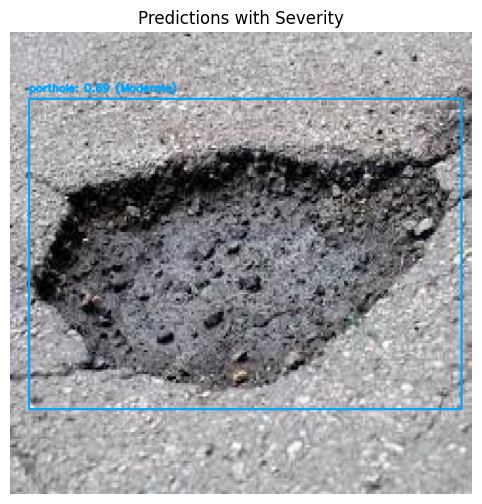


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/G0027506_JPG.rf.5e2aac444538230ff6eca2ff899c6556.jpg: 640x640 5 portholes, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


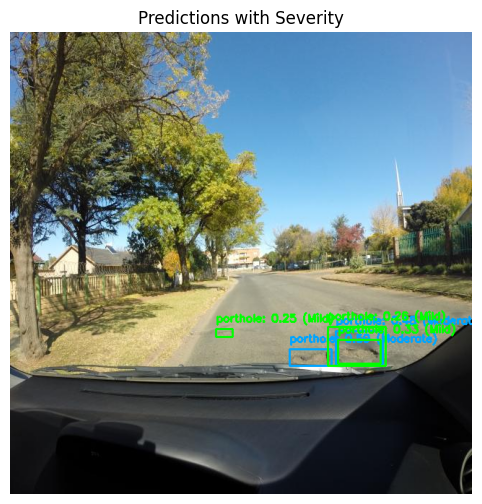


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1014901_RS_386_386RS124739_31430_RAW_jpg.rf.a03df9edd4b471b9dafc29cce27eaf9e.jpg: 640x640 (no detections), 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


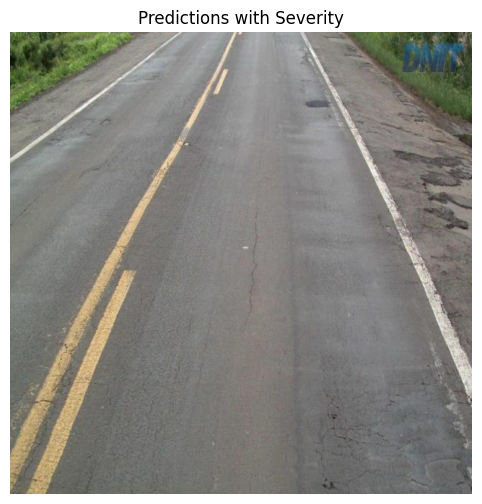


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/1078403_DF_010_010BDF0030_1_00189_RAW_jpg.rf.7b0d9d8b59f6762f145b2d87f1ab77f4.jpg: 640x640 (no detections), 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


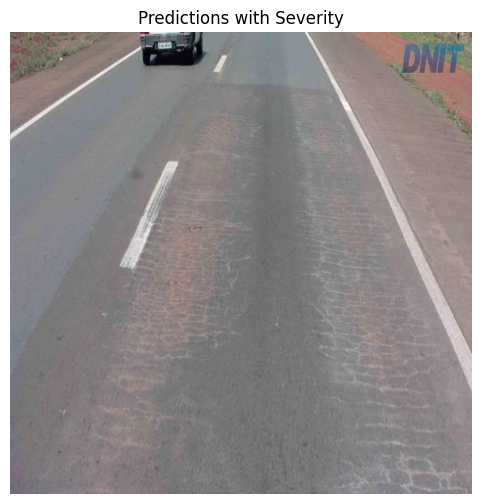


image 1/1 /kaggle/input/yolo-v-11-combined/YOLO_V11_Combined/test/images/10_jpg.rf.78185c173c5c1b65c5df8aece0ed0312.jpg: 640x640 2 portholes, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


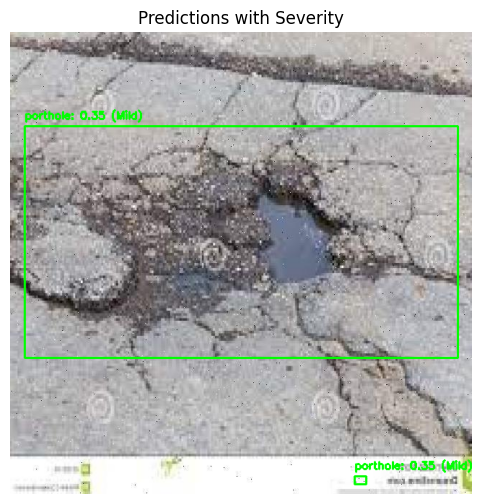

Predictions saved in 'predictions'.


In [14]:
# Step 8: Visualize Model Predictions with Severity
def get_severity_label(score):
    """Determine severity based on confidence score."""
    if score >= 0.75:
        return "Severe", (255, 0, 0)  # Red for severe
    elif 0.4 <= score < 0.75:
        return "Moderate", (0, 165, 255)  # Orange for moderate
    else:
        return "Mild", (0, 255, 0)  # Green for mild

def visualize_predictions(model, test_images, output_dir='predictions'):
    """
    Visualize YOLO model predictions with severity levels.

    Args:
        model: Trained YOLO model.
        test_images (list): List of test image paths.
        output_dir (str): Directory to save prediction images.
    """
    os.makedirs(output_dir, exist_ok=True)

    for image_path in test_images:
        # Load image
        img = cv2.imread(image_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Make prediction
        results = model.predict(image_path, batch=16, device=0, save=False)

        for result in results:
            # Get detected bounding boxes, confidence scores, and class labels
            boxes = result.boxes.xyxy.cpu().numpy()  # Bounding box coordinates
            scores = result.boxes.conf.cpu().numpy()  # Confidence scores
            class_ids = result.boxes.cls.cpu().numpy().astype(int)  # Class indices

            # Plot results on image
            for box, score, class_id in zip(boxes, scores, class_ids):
                x1, y1, x2, y2 = map(int, box)

                # Get severity label and corresponding color
                severity, color = get_severity_label(score)

                # Define label with severity and confidence score
                label = f"{model.names[class_id]}: {score:.2f} ({severity})"

                # Draw bounding box
                cv2.rectangle(img_rgb, (x1, y1), (x2, y2), color, 2)

                # Put text label
                cv2.putText(img_rgb, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 
                            0.5, color, 2)

            # Save the image with predictions
            save_path = os.path.join(output_dir, os.path.basename(image_path))
            cv2.imwrite(save_path, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))

            # Show image (optional)
            plt.figure(figsize=(8, 6))
            plt.imshow(img_rgb)
            plt.axis("off")
            plt.title("Predictions with Severity")
            plt.show()

    print(f"Predictions saved in '{output_dir}'.")

# Hyperparameters for training
hyperparams = {
    'lr0': 0.01,
    'momentum': 0.937,
    'weight_decay': 0.0005,
    'warmup_epochs': 3,
}

# Train the model and capture the results and model
results, model = train_yolo_model('dataset.yaml', epochs=100, imgsz=640, hyperparams=hyperparams)

# Save metrics plots using the results object
save_metrics_plots(results)

# Ensure only image files are selected
test_images_dir = os.path.join(test_path, 'images')
test_images = [
    os.path.join(test_images_dir, f)
    for f in os.listdir(test_images_dir)
    if f.lower().endswith(('.jpg', '.png', '.jpeg'))
]

# Visualize predictions with severity
visualize_predictions(model, test_images)